## Sacramento, CA Weather Forecast with Machine Learning

### Daily Summaries Station Details

Data comes from [NOAA](https://www.ncdc.noaa.gov/cdo-web/datasets/GHCND/stations/GHCND:USW00023232/detail)
</p>
<p>Name:	SACRAMENTO AIRPORT ASOS, CA US
</p>
<p>Network:ID	GHCND:USW00023232
</p>
<p>Latitude/Longitude:	38.50659°, -121.49604°
</p>
<p>Elevation:	5.9 m
</p>
<p>PERIOD OF RECORD:
</p>
<p>Start Date	1941-11-10
</p>
<p>End Date	2022-11-26
</p>

In [1]:
# reading in the intial data. I used data from 

import pandas as pd
weather = pd.read_csv("local_weather.csv", index_col='DATE')

In [2]:
weather.head()

,STATION,NAME,ACMH,ACSH,AWND,DAPR,FMTM,FRGT,MDPR,PGTM,...,WT09,WT10,WT13,WT14,WT16,WT18,WT21,WT22,WV03,WV20
DATE,,,,,,,,,,,,,,,,,,,,,
1941-11-10,USW00023232,"SACRAMENTO AIRPORT ASOS, CA US",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1941-11-11,USW00023232,"SACRAMENTO AIRPORT ASOS, CA US",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1941-11-12,USW00023232,"SACRAMENTO AIRPORT ASOS, CA US",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1941-11-13,USW00023232,"SACRAMENTO AIRPORT ASOS, CA US",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1941-11-14,USW00023232,"SACRAMENTO AIRPORT ASOS, CA US",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [3]:
# test
weather.loc["1960-01-01",:]  # or weather.loc["1960-01-01"] 

STATION                       USW00023232
NAME       SACRAMENTO AIRPORT ASOS, CA US
ACMH                                  NaN
ACSH                                  NaN
AWND                                  NaN
DAPR                                  NaN
FMTM                                  NaN
FRGT                                  NaN
MDPR                                  NaN
PGTM                                  NaN
PRCP                                  0.0
PSUN                                  NaN
SNOW                                  0.0
SNWD                                  0.0
TAVG                                  NaN
TMAX                                 45.0
TMIN                                 28.0
TSUN                                  NaN
WDF1                                  NaN
WDF2                                  NaN
WDF5                                  NaN
WDFG                                  NaN
WDFM                                  NaN
WESD                              

In [4]:
# test
weather.loc["1960-01-01":"1960-01-31", :]

,STATION,NAME,ACMH,ACSH,AWND,DAPR,FMTM,FRGT,MDPR,PGTM,...,WT09,WT10,WT13,WT14,WT16,WT18,WT21,WT22,WV03,WV20
DATE,,,,,,,,,,,,,,,,,,,,,
1960-01-01,USW00023232,"SACRAMENTO AIRPORT ASOS, CA US",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1960-01-02,USW00023232,"SACRAMENTO AIRPORT ASOS, CA US",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1960-01-03,USW00023232,"SACRAMENTO AIRPORT ASOS, CA US",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1960-01-04,USW00023232,"SACRAMENTO AIRPORT ASOS, CA US",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1960-01-05,USW00023232,"SACRAMENTO AIRPORT ASOS, CA US",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1960-01-06,USW00023232,"SACRAMENTO AIRPORT ASOS, CA US",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1960-01-07,USW00023232,"SACRAMENTO AIRPORT ASOS, CA US",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN
1960-01-08,USW00023232,"SACRAMENTO AIRPORT ASOS, CA US",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN
1960-01-09,USW00023232,"SACRAMENTO AIRPORT ASOS, CA US",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN


In [5]:
# cleaning data
# finding null percentages accross all columns
weather.apply(pd.isnull).sum()/weather.shape[0] * 100

STATION     0.000000
NAME        0.000000
ACMH       61.544953
ACSH       57.958581
AWND       51.432791
DAPR       99.996484
FMTM       82.549840
FRGT       99.989452
MDPR       99.996484
PGTM       77.441018
PRCP        0.031644
PSUN       75.605640
SNOW       30.761928
SNWD       32.917267
TAVG       78.246194
TMAX        0.063289
TMIN        0.070321
TSUN       57.923420
WDF1       99.310854
WDF2       66.203720
WDF5       68.921627
WDFG       94.050842
WDFM       60.954256
WESD       79.339686
WSF1       99.314370
WSF2       66.203720
WSF5       68.921627
WSFG       94.050842
WSFM       60.954256
WT01       71.569213
WT02       93.502338
WT03       98.811575
WT04       99.989452
WT05       99.233501
WT07       99.479624
WT08       73.394044
WT09       99.736296
WT10       99.996484
WT13       92.074822
WT14       99.423368
WT16       82.127914
WT18       99.922647
WT21       99.869906
WT22       99.915615
WV03       99.936711
WV20       99.975388
dtype: float64

In [6]:
# taking a few columns from the dataset crating a new datafram
# according the documention The five core values are: "PRCP", "SNOW", "SNWD", "TMIN", "TMAX"
core_weather= weather[["PRCP", "SNOW", "SNWD", "TMIN", "TMAX"]].copy()

In [7]:
# renaming the columns
core_weather.columns = ["precip", "snow", "snow_depth","temp_min", "temp_max"]

In [8]:
core_weather

,precip,snow,snow_depth,temp_min,temp_max
DATE,,,,,
1941-11-10,0.0,0.0,0.0,47.0,70.0
1941-11-11,0.0,0.0,0.0,46.0,73.0
1941-11-12,0.0,0.0,0.0,50.0,69.0
1941-11-13,0.0,0.0,0.0,47.0,70.0
1941-11-14,0.0,0.0,0.0,48.0,75.0
...,...,...,...,...,...
2022-11-22,0.0,0.0,NaN,32.0,64.0
2022-11-23,0.0,0.0,NaN,33.0,68.0
2022-11-24,0.0,0.0,NaN,34.0,68.0


In [9]:
# finding null percentages in the new dataframe
core_weather.apply(pd.isnull).sum()/core_weather.shape[0] * 100

precip         0.031644
snow          30.761928
snow_depth    32.917267
temp_min       0.070321
temp_max       0.063289
dtype: float64

In [10]:
# let's see how we want to deal with these null values
core_weather["snow"].value_counts()

0.0    19691
2.0        1
Name: snow, dtype: int64

In [11]:
# only one day rained and it was about 2 inches of snow fall!
# so we are going to delete that column
del core_weather["snow"]

In [12]:
# let's take a look at the snow depth
core_weather["snow_depth"].value_counts()

0.0    19079
Name: snow_depth, dtype: int64

In [13]:
# 0 inches of snow deapth on the ground!
# we are going to delete this column too

del core_weather["snow_depth"]

In [14]:
# select rows where precipitaion was null
core_weather[pd.isnull(core_weather["precip"])]

,precip,temp_min,temp_max
DATE,,,
1981-11-26,NaN,49.0,55.0
1994-09-28,NaN,60.0,80.0
1994-10-04,NaN,55.0,64.0
1994-10-05,NaN,51.0,72.0
1994-11-04,NaN,37.0,61.0
1994-11-05,NaN,48.0,54.0
1994-11-06,NaN,49.0,55.0
1994-11-09,NaN,43.0,55.0
1994-11-15,NaN,40.0,48.0


In [15]:
# let's find out what were the percipitation values preceding and subsequent 1981-11-26
core_weather.loc["1981-11-20":"1981-11-30",:]

,precip,temp_min,temp_max
DATE,,,
1981-11-20,0.00,56.0,67.0
1981-11-21,0.68,57.0,63.0
1981-11-22,0.02,60.0,69.0
1981-11-23,0.03,61.0,72.0
1981-11-24,0.00,46.0,66.0
1981-11-25,0.00,46.0,61.0
1981-11-26,NaN,49.0,55.0
1981-11-27,1.00,49.0,55.0
1981-11-28,0.00,46.0,62.0


In [16]:
# let's find out what were the percipitation values preceding and subsequent 1994-10-04
core_weather.loc["1994-09-20":"1994-10-10",:]

,precip,temp_min,temp_max
DATE,,,
1994-09-20,0.0,54.0,99.0
1994-09-21,0.0,56.0,96.0
1994-09-22,0.0,57.0,92.0
1994-09-23,0.0,60.0,81.0
1994-09-24,0.0,59.0,90.0
1994-09-25,0.0,57.0,91.0
1994-09-26,0.0,57.0,98.0
1994-09-27,0.0,56.0,85.0
1994-09-28,NaN,60.0,80.0


In [17]:
# let's find out what were the percipitation values preceding and subsequent 1994-11-09
core_weather.loc["1994-11-01":"1994-11-20",:]

,precip,temp_min,temp_max
DATE,,,
1994-11-01,0.0,51.0,65.0
1994-11-02,0.0,41.0,62.0
1994-11-03,0.0,38.0,61.0
1994-11-04,NaN,37.0,61.0
1994-11-05,NaN,48.0,54.0
1994-11-06,NaN,49.0,55.0
1994-11-07,0.0,47.0,63.0
1994-11-08,0.0,37.0,64.0
1994-11-09,NaN,43.0,55.0


In [18]:
# two stategies: 
# forward-fill (replace it with the value that came directly before it) 
# or 
# replace all the null values with zero.
# because for most days there were no precipitation we will pick the second approach
core_weather["precip"].value_counts()

0.00    23908
0.01      440
0.02      273
0.03      233
0.04      177
        ...  
1.43        1
1.48        1
2.08        1
1.33        1
2.51        1
Name: precip, Length: 205, dtype: int64

In [19]:
core_weather["precip"] = core_weather["precip"].fillna(0)

In [20]:
# next we are going to look into missing values in temp_min and temp_max columns
# select rows where temp_min was null
core_weather[pd.isnull(core_weather["temp_min"])]

,precip,temp_min,temp_max
DATE,,,
1994-10-15,0.0,NaN,NaN
1994-10-16,0.0,NaN,NaN
1994-10-17,0.0,NaN,NaN
1994-10-18,0.0,NaN,NaN
1994-10-19,0.0,NaN,NaN
1994-10-20,0.0,NaN,NaN
1994-10-21,0.0,NaN,NaN
1994-10-22,0.0,NaN,NaN
1994-10-23,0.0,NaN,NaN


In [21]:
# select rows where temp_max was null
core_weather[pd.isnull(core_weather["temp_max"])]

,precip,temp_min,temp_max
DATE,,,
1994-10-15,0.0,NaN,NaN
1994-10-16,0.0,NaN,NaN
1994-10-17,0.0,NaN,NaN
1994-10-18,0.0,NaN,NaN
1994-10-19,0.0,NaN,NaN
1994-10-20,0.0,NaN,NaN
1994-10-21,0.0,NaN,NaN
1994-10-22,0.0,NaN,NaN
1994-10-23,0.0,NaN,NaN


In [22]:
# for these two columns we will use forward-fill startegy
core_weather = core_weather.fillna(method="ffill")

In [23]:
# let's see if we have any null left
# finding null percentages
core_weather.apply(pd.isnull).sum()/core_weather.shape[0] * 100

precip      0.0
temp_min    0.0
temp_max    0.0
dtype: float64

In [24]:
# Check to see if the value 9999, which indicates a measurement error, is in any of the columns.

core_weather.apply(lambda x: (x==9999).sum()) 

precip      0
temp_min    0
temp_max    0
dtype: int64

In [25]:
# check the top 5 rows
core_weather.head()

,precip,temp_min,temp_max
DATE,,,
1941-11-10,0.0,47.0,70.0
1941-11-11,0.0,46.0,73.0
1941-11-12,0.0,50.0,69.0
1941-11-13,0.0,47.0,70.0
1941-11-14,0.0,48.0,75.0


In [26]:
# check the data type
core_weather.dtypes

precip      float64
temp_min    float64
temp_max    float64
dtype: object

In [27]:
# check the index type 
core_weather.index

Index(['1941-11-10', '1941-11-11', '1941-11-12', '1941-11-13', '1941-11-14',
       '1941-11-15', '1941-11-16', '1941-11-17', '1941-11-18', '1941-11-19',
       ...
       '2022-11-17', '2022-11-18', '2022-11-19', '2022-11-20', '2022-11-21',
       '2022-11-22', '2022-11-23', '2022-11-24', '2022-11-25', '2022-11-26'],
      dtype='object', name='DATE', length=28441)

In [28]:
# index type was string, let's conver it to "datetime"
core_weather.index = pd.to_datetime(core_weather.index)

In [29]:
# let's check it to see if it is converted
core_weather.index

DatetimeIndex(['1941-11-10', '1941-11-11', '1941-11-12', '1941-11-13',
               '1941-11-14', '1941-11-15', '1941-11-16', '1941-11-17',
               '1941-11-18', '1941-11-19',
               ...
               '2022-11-17', '2022-11-18', '2022-11-19', '2022-11-20',
               '2022-11-21', '2022-11-22', '2022-11-23', '2022-11-24',
               '2022-11-25', '2022-11-26'],
              dtype='datetime64[ns]', name='DATE', length=28441, freq=None)

In [30]:
# we can check the year, month, or day in the index now
core_weather.index.year  # core_weather.index.month or core_weather.index.day

Int64Index([1941, 1941, 1941, 1941, 1941, 1941, 1941, 1941, 1941, 1941,
            ...
            2022, 2022, 2022, 2022, 2022, 2022, 2022, 2022, 2022, 2022],
           dtype='int64', name='DATE', length=28441)

<AxesSubplot:xlabel='DATE'>

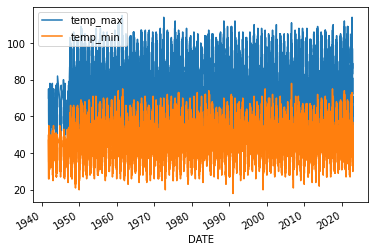

In [31]:
# let's plot max temp and min temp by day to see if there is anything crazy going on in the data at this point
core_weather[["temp_max", "temp_min"]].plot()

In [32]:
# to have no row limit for one dataframe df:

# pd.options.display.max_rows = None or any number

pd.options.display.max_rows = None

In [33]:
# let's find out if there is any gap in the plot above  ... how many obsevations exist for each year?
core_weather.index.year.value_counts().sort_index()

1941     52
1942    151
1943    151
1944    152
1945    151
1946    151
1947    274
1948    366
1949    365
1950    365
1951    365
1952    366
1953    365
1954    365
1955    365
1956    366
1957    365
1958    365
1959    365
1960    366
1961    365
1962    365
1963    365
1964    366
1965    365
1966    365
1967    365
1968    366
1969    365
1970    365
1971    365
1972    366
1973    365
1974    365
1975    365
1976    366
1977    365
1978    365
1979    365
1980    366
1981    365
1982    365
1983    365
1984    366
1985    365
1986    365
1987    365
1988    366
1989    365
1990    365
1991    365
1992    366
1993    365
1994    365
1995    365
1996    366
1997    365
1998    365
1999    365
2000    366
2001    365
2002    365
2003    365
2004    366
2005    365
2006    365
2007    365
2008    366
2009    365
2010    365
2011    365
2012    366
2013    365
2014    365
2015    365
2016    366
2017    365
2018    365
2019    365
2020    366
2021    365
2022    330
Name: DATE, dtyp

In [34]:
# There some missing observations in 1941-1947, but since we are just using this historical data to predict the future
# they are not that important. There are also some too high temperature seen in the plot above, but we won't be too much
# worry about them at the moment.

<AxesSubplot:xlabel='DATE'>

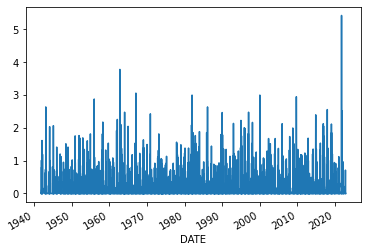

In [35]:
# plot the precipitation column
core_weather["precip"].plot()

In [36]:
# how much it rained each year

core_weather.groupby(core_weather.index.year).sum()["precip"]

DATE
1941     5.27
1942    13.72
1943    13.47
1944    15.44
1945    13.94
1946     6.61
1947     8.91
1948    16.89
1949    10.41
1950    21.81
1951    14.44
1952    23.93
1953     9.57
1954    18.86
1955    22.26
1956    12.78
1957    16.98
1958    24.38
1959    12.77
1960    15.20
1961    13.22
1962    21.58
1963    21.64
1964    16.70
1965    13.81
1966    13.78
1967    19.62
1968    14.90
1969    23.92
1970    23.07
1971     9.78
1972    13.91
1973    26.48
1974    15.16
1975    13.18
1976     6.25
1977    11.71
1978    23.74
1979    20.34
1980    19.34
1981    22.33
1982    31.60
1983    33.44
1984     9.49
1985    11.56
1986    18.14
1987    15.83
1988    12.04
1989    15.11
1990    13.76
1991    13.89
1992    16.51
1993    23.36
1994    11.06
1995    25.62
1996    22.45
1997    19.56
1998    27.84
1999    11.44
2000    22.59
2001    21.50
2002    16.98
2003    14.51
2004    17.56
2005    22.17
2006    17.77
2007    11.73
2008    13.30
2009    18.88
2010    22.84
2011    16.94
2

<AxesSubplot:xlabel='DATE'>

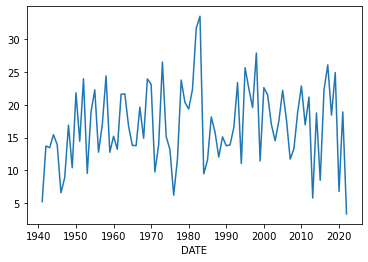

In [37]:
# plot the annual rain calculated above
core_weather.groupby(core_weather.index.year).sum()["precip"].plot()

In [38]:
# predict tomorrow's maximum temprature using historical data
core_weather["target"] = core_weather.shift(-1)["temp_max"]  
# using shift (-1) we are saying today's target is coming from tomorrow's max temp

In [40]:
core_weather

,precip,temp_min,temp_max,target
DATE,,,,
1941-11-10,0.00,47.0,70.0,73.0
1941-11-11,0.00,46.0,73.0,69.0
1941-11-12,0.00,50.0,69.0,70.0
1941-11-13,0.00,47.0,70.0,75.0
1941-11-14,0.00,48.0,75.0,71.0
1941-11-15,0.00,50.0,71.0,64.0
1941-11-16,0.00,47.0,64.0,56.0
1941-11-17,0.00,36.0,56.0,59.0
1941-11-18,0.00,31.0,59.0,56.0


In [41]:
# since there isn't any temperature recorded on 2022-11-27 to be used 
# as target value for 2022-11-26 we will get rid of the last row

core_weather = core_weather.iloc[:-1,:].copy()

In [42]:
core_weather

,precip,temp_min,temp_max,target
DATE,,,,
1941-11-10,0.00,47.0,70.0,73.0
1941-11-11,0.00,46.0,73.0,69.0
1941-11-12,0.00,50.0,69.0,70.0
1941-11-13,0.00,47.0,70.0,75.0
1941-11-14,0.00,48.0,75.0,71.0
1941-11-15,0.00,50.0,71.0,64.0
1941-11-16,0.00,47.0,64.0,56.0
1941-11-17,0.00,36.0,56.0,59.0
1941-11-18,0.00,31.0,59.0,56.0


In [46]:
# machine learning using ridge regression (a type of regression that minimizes overfitting)
from sklearn.linear_model import Ridge  # import the model

reg = Ridge (alpha = 0.1) # initialize the model

In [47]:
# create a list of predictors
predictors = ["precip", "temp_max", "temp_min"]

In [48]:
# split the data to training set and test set
train = core_weather.loc[:"2021-12-31"]
test = core_weather.loc["2022-01-01":]

In [50]:
# fit the training dataset 
reg.fit(train[predictors], train["target"])

Ridge(alpha=0.1)

In [53]:
# generate prediction
predictions = reg.predict(test[predictors])

In [54]:
# let's see how we did

from sklearn.metrics import mean_absolute_error
mean_absolute_error(test["target"], predictions)

4.10314616684182

In [59]:
# combine the actual target with the prediction values

combined = pd.concat([test["target"], pd.Series(predictions, index = test.index)], axis=1)
combined.columns = ["actual", "predictions"]

In [60]:
combined

,actual,predictions
DATE,,
2022-01-01,52.0,51.755768
2022-01-02,53.0,51.982441
2022-01-03,57.0,53.252256
2022-01-04,60.0,59.250658
2022-01-05,53.0,61.105435
2022-01-06,55.0,55.341805
2022-01-07,57.0,56.443441
2022-01-08,57.0,57.684312
2022-01-09,61.0,57.292726


<AxesSubplot:xlabel='DATE'>

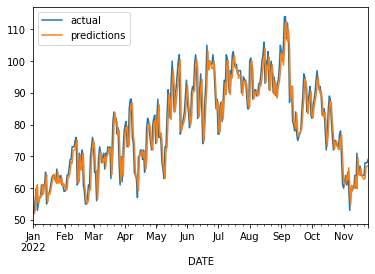

In [61]:
combined.plot()

In [62]:
# coefficients of our regression model to see how different variable is being used by the model 
reg.coef_

array([-0.10882469,  0.87931668,  0.13052884])

In [63]:
# rain has a negetive imparct on tomorrow's max temp
# today's max temp has the biggest impact on tomorrow's max temp prediction

In [74]:
# Building a Prediction Function
def create_predictions (predictors, core_weather, reg):
    train = core_weather.loc[:"2021-12-31"]
    test = core_weather.loc["2022-01-01":]
    reg.fit(train[predictors], train["target"])
    predictions = reg.predict(test[predictors])
    error = mean_absolute_error(test["target"], predictions)
    combined = pd.concat([test["target"], pd.Series(predictions, index = test.index)], axis=1)
    combined.columns = ["actual", "predictions"]
    return error, combined

In [90]:
# what is the average max-temperature in a given month
core_weather ["month_max_avg"] = core_weather["temp_max"].rolling(30).mean() # using the past 30 days tem_max mean

In [67]:
core_weather

,precip,temp_min,temp_max,target,month_max
DATE,,,,,
1941-11-10,0.00,47.0,70.0,73.0,NaN
1941-11-11,0.00,46.0,73.0,69.0,NaN
1941-11-12,0.00,50.0,69.0,70.0,NaN
1941-11-13,0.00,47.0,70.0,75.0,NaN
1941-11-14,0.00,48.0,75.0,71.0,NaN
1941-11-15,0.00,50.0,71.0,64.0,NaN
1941-11-16,0.00,47.0,64.0,56.0,NaN
1941-11-17,0.00,36.0,56.0,59.0,NaN
1941-11-18,0.00,31.0,59.0,56.0,NaN


In [91]:
# how different is the monthly average max-temperature form max-temperature in a given day
core_weather["month_max_day"] = core_weather["month_max_avg"] / core_weather["temp_max"]

In [92]:
# how different is the max from the min
core_weather["max_min"] = core_weather["temp_max"] / core_weather["temp_min"]

In [93]:
# create a NEW list of predictors with the new variables 
predictors = ["precip", "temp_max", "temp_min", "month_max_avg", "month_max_day", "max_min"]

In [94]:
# since the first 29 rows of the core_weather has NaN values we need to remove them before we use them in the mdoel
core_weather = core_weather.iloc[30:, :].copy()

In [95]:
error, combined = create_predictions(predictors, core_weather, reg)

In [96]:
error

4.109959094279888

In [97]:
# comparing with the previous error value this new predictors have not improved our predictions

In [99]:
# monthly average temperature historically in a given month.
core_weather["monthly_avg"] = core_weather["temp_max"].groupby(core_weather.index.month).apply(lambda x: x.expanding(1).mean())
                                           
# groups all the max temp in january together, in february together, etc. regardless what year they found.

In [100]:
core_weather

,precip,temp_min,temp_max,target,month_max,month_day_max,month_max_day,max_min,month_max_avg,monthly_avg
DATE,,,,,,,,,,
1942-03-10,1.19,49.0,57.0,63.0,61.566667,1.080117,1.080117,1.163265,61.566667,57.000000
1942-03-11,0.10,50.0,63.0,61.0,61.666667,0.978836,0.978836,1.260000,61.666667,60.000000
1942-03-12,0.00,42.0,61.0,55.0,61.466667,1.007650,1.007650,1.452381,61.466667,60.333333
1942-03-13,0.12,40.0,55.0,46.0,61.133333,1.111515,1.111515,1.375000,61.133333,59.000000
1942-03-14,1.11,32.0,46.0,58.0,60.666667,1.318841,1.318841,1.437500,60.666667,56.400000
1942-03-15,0.00,34.0,58.0,63.0,60.666667,1.045977,1.045977,1.705882,60.666667,56.666667
1942-03-16,0.00,36.0,63.0,67.0,60.833333,0.965608,0.965608,1.750000,60.833333,57.571429
1942-03-17,0.00,39.0,67.0,63.0,61.133333,0.912438,0.912438,1.717949,61.133333,58.750000
1942-03-18,0.00,42.0,63.0,64.0,61.233333,0.971958,0.971958,1.500000,61.233333,59.222222


In [102]:
# avg temperature of let's say 213th day of the year

core_weather["day_of_year_avg"] = core_weather["temp_max"].groupby(core_weather.index.day_of_year).apply(lambda x: x.expanding(1).mean())

In [103]:
predictors = predictors = ["precip", "temp_max", "temp_min", "month_max_avg", "month_max_day", "max_min", "monthly_avg", "day_of_year_avg"]

In [104]:
error, combined = create_predictions(predictors, core_weather, reg)

In [105]:
error

4.1222441139204955

In [106]:
# still no imporvement

In [107]:
reg.coef_

array([ 0.72024479,  0.76081678,  0.03947455, -0.05182619,  3.78285747,
        0.84268633,  0.10279794,  0.16425093])

In [108]:
# which columns correlates with our target? Depending on their impacts on the target
# we can figure out which columns we would want to use and which ones not

core_weather.corr()["target"]

precip            -0.229614
temp_min           0.802154
temp_max           0.941620
target             1.000000
month_max          0.858236
month_day_max     -0.344808
month_max_day     -0.344808
max_min            0.344091
month_max_avg      0.858236
monthly_avg        0.875971
day_of_year_avg    0.890767
Name: target, dtype: float64

In [111]:
combined["diff"] = (combined["actual"] - combined["predictions"]).abs()

In [113]:
# biggest differents
combined.sort_values("diff", ascending=False).head()

,actual,predictions,diff
DATE,,,
2022-05-25,77.0,96.629529,19.629529
2022-09-09,87.0,101.583721,14.583721
2022-06-11,82.0,95.687068,13.687068
2022-09-04,114.0,101.053015,12.946985
2022-06-20,105.0,92.112548,12.887452
